In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cp /content/drive/MyDrive/College/Thesis/Data/Ireland_Road_Damage_Test_Set.v2_pascal_voc.zip ./

In [3]:
!unzip  Ireland_Road_Damage_Test_Set.v2_pascal_voc.zip

Archive:  Ireland_Road_Damage_Test_Set.v2_pascal_voc.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/BelfastVideo1_scene01881_jpg.rf.3d866356d50fceb7794150d165e10ce9.jpg  
 extracting: test/BelfastVideo1_scene01881_jpg.rf.3d866356d50fceb7794150d165e10ce9.xml  
 extracting: test/BelfastVideo1_scene02141_jpg.rf.4d24ff3ce4e4d3224adb219337cc9c2f.jpg  
 extracting: test/BelfastVideo1_scene02141_jpg.rf.4d24ff3ce4e4d3224adb219337cc9c2f.xml  
 extracting: test/BelfastVideo1_scene02441_jpg.rf.580706f4699527cfce3470b1cb02990a.jpg  
 extracting: test/BelfastVideo1_scene02441_jpg.rf.580706f4699527cfce3470b1cb02990a.xml  
 extracting: test/BelfastVideo1_scene02461_jpg.rf.b0c996c2d798186136e63dfe573ba4a0.jpg  
 extracting: test/BelfastVideo1_scene02461_jpg.rf.b0c996c2d798186136e63dfe573ba4a0.xml  
 extracting: test/BelfastVideo1_scene02851_jpg.rf.172b728c61e2aef67fa56cd3c03acdb4.jpg  
 extracting: test/BelfastVideo1_scene02851_jpg.

In [4]:
from PIL import Image
import xml.etree.ElementTree as ET
import cv2

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

def generate_chart(labels, title):
  '''
  This function is used to create count plot.
  Reference : https://stackoverflow.com/questions/63603222/adding-percentages-to-sns-countplot-how-do-i-show-percentages-for-two-values-w
  Parameters : labels - numpy array, title - string
  Print : a countplot
  '''
  plt.figure(figsize=(7, 5))
  ax = sns.countplot(labels)
  plt.xticks(size=12)
  plt.xlabel('Damage Type', size=14)
  plt.yticks(size=12)
  plt.ylabel('Count', size=12)
  plt.title(title, size=16)

  total = len(labels)
  for p in ax.patches:
      percentage = f'{100 * p.get_height() / total:.3f}%\n'
      x = p.get_x() + p.get_width() / 2
      y = p.get_height()
      ax.annotate(percentage, (x, y), ha='center', va='center')
  plt.tight_layout()
  plt.grid()

In [5]:

def filter_out_unused_labels(df):
  cleaned_indexes = []
  labels = []
  for i, row in df.iterrows():
    tree = ET.parse(row['annotations'])
    root = tree.getroot()
    for elem in root:
      for subelem in elem:
        print(subelem)
        print(subelem is None)
        print(subelem.text)
        print(type(subelem.text))
        if subelem.text is not None and (('D00' in subelem.text) or ('D10' in subelem.text) or ('D20' in subelem.text) or ('D40' in subelem.text)):
          labels.append(subelem.text)
          if i not in cleaned_indexes:
            cleaned_indexes.append(i)

  return cleaned_indexes, labels

In [6]:
import os
import glob

def binder(folder = '/content/test'):
  '''
  This function is used to create two lists, one for containing all images and another for all annotations.
  Return : two lists - all_images and all_annotations
  '''

  all_images = []
  all_annotations = []
  for each_image in sorted(glob.glob(folder + '/*.jpg')):
    all_images.append(each_image)

  for each_xml in sorted(glob.glob(folder + '/*.xml')):
    all_annotations.append(each_xml)

  return all_images, all_annotations

In [7]:
imgs, annots = binder()

In [8]:
print(len(annots))

160


In [9]:
import pandas as pd

dataset = pd.DataFrame({'images' : imgs, 'annotations' : annots})
dataset.head()

,images,annotations
0,/content/test/BelfastVideo1_scene01881_jpg.rf....,/content/test/BelfastVideo1_scene01881_jpg.rf....
1,/content/test/BelfastVideo1_scene02141_jpg.rf....,/content/test/BelfastVideo1_scene02141_jpg.rf....
2,/content/test/BelfastVideo1_scene02441_jpg.rf....,/content/test/BelfastVideo1_scene02441_jpg.rf....
3,/content/test/BelfastVideo1_scene02461_jpg.rf....,/content/test/BelfastVideo1_scene02461_jpg.rf....
4,/content/test/BelfastVideo1_scene02851_jpg.rf....,/content/test/BelfastVideo1_scene02851_jpg.rf....


In [10]:
df_imgs, df_labels = filter_out_unused_labels(dataset)

Streaming output truncated to the last 5000 lines.
<class 'str'>
<Element 'height' at 0x7fe2b72964d0>
False
1088
<class 'str'>
<Element 'depth' at 0x7fe2b72967d0>
False
3
<class 'str'>
<Element 'name' at 0x7fe2b7296c50>
False
D00
<class 'str'>
<Element 'pose' at 0x7fe2b72b48f0>
False
Unspecified
<class 'str'>
<Element 'truncated' at 0x7fe2b72b4b30>
False
0
<class 'str'>
<Element 'difficult' at 0x7fe2b72b4ad0>
False
0
<class 'str'>
<Element 'occluded' at 0x7fe2b72b4c50>
False
0
<class 'str'>
<Element 'bndbox' at 0x7fe2b72b4bf0>
False

			
<class 'str'>
<Element 'database' at 0x7fe2b72b0830>
False
roboflow.ai
<class 'str'>
<Element 'width' at 0x7fe2b72b0a70>
False
1920
<class 'str'>
<Element 'height' at 0x7fe2b72b01d0>
False
1088
<class 'str'>
<Element 'depth' at 0x7fe2b72b4830>
False
3
<class 'str'>
<Element 'name' at 0x7fe2b72b4b90>
False
D40
<class 'str'>
<Element 'pose' at 0x7fe2b72b4e90>
False
Unspecified
<class 'str'>
<Element 'truncated' at 0x7fe2b72b4ef0>
False
0
<class 'str'>
<E

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


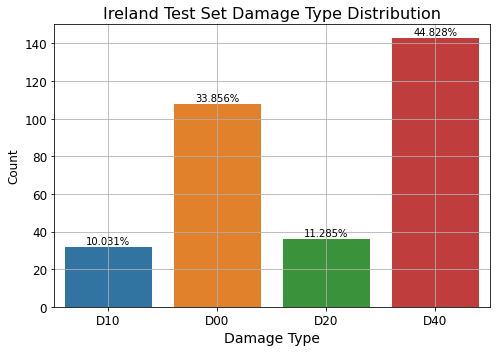

In [11]:
# plotting countplot
generate_chart(df_labels, 'Ireland Test Set Damage Type Distribution')

In [12]:
def draw_bb(image_file, xml_file):
  '''
  This function is used to create bounding boxes and putting text(label) on the image, based on annotations.
  Reference : https://github.com/sekilab/RoadDamageDetector/blob/master/RoadDamageDatasetTutorial.ipynb
  Parameters : image_file - string, xml_file - string
  Return : img - a image
  '''
  img = cv2.imread(image_file)
  infile_xml = open(xml_file)
  tree = ET.parse(infile_xml)
  root = tree.getroot()
  print(image_file)
  for obj in root.iter('object'):
    cls_name = obj.find('name').text
    if ('D00' in cls_name) or ('D10' in cls_name) or ('D20' in cls_name) or ('D40' in cls_name):
      xmlbox = obj.find('bndbox')
      print(xmlbox.find('xmin').text)
      xmin = int(float(xmlbox.find('xmin').text))
      xmax = int(float(xmlbox.find('xmax').text))
      ymin = int(float(xmlbox.find('ymin').text))
      ymax = int(float(xmlbox.find('ymax').text))

      font = cv2.FONT_HERSHEY_SIMPLEX

      # put text
      cv2.putText(img,cls_name,(xmin,ymin-10),font,1,(0,255,0),2,cv2.LINE_AA)

      # draw bounding box
      cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0,255,0),3)

  return img

test/BelfastVideo1_scene02141_jpg.rf.4d24ff3ce4e4d3224adb219337cc9c2f.jpg
624
947


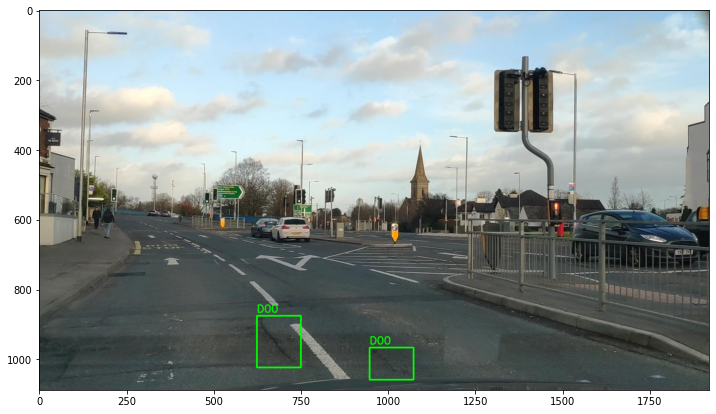

In [13]:
img = draw_bb('test/BelfastVideo1_scene02141_jpg.rf.4d24ff3ce4e4d3224adb219337cc9c2f.jpg', 'test/BelfastVideo1_scene02141_jpg.rf.4d24ff3ce4e4d3224adb219337cc9c2f.xml')
plt.figure(figsize=(12,8))
plt.subplot(1,1,1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

test/BelfastVideo1_scene02441_jpg.rf.580706f4699527cfce3470b1cb02990a.jpg
1264
1230
1148


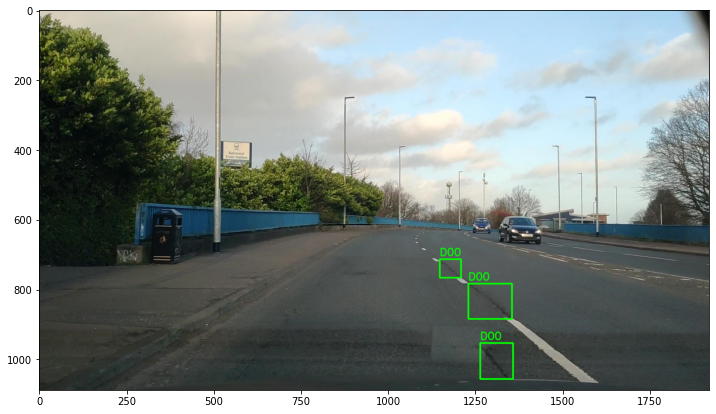

In [14]:
img = draw_bb('test/BelfastVideo1_scene02441_jpg.rf.580706f4699527cfce3470b1cb02990a.jpg', 'test/BelfastVideo1_scene02441_jpg.rf.580706f4699527cfce3470b1cb02990a.xml')
plt.figure(figsize=(12,8))
plt.subplot(1,1,1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

/content/test/DublinVideo1_scene01851_jpg.rf.8e93abb5b9884b43e60586b0ad79e7bf.jpg
1461
1014
1261
1311


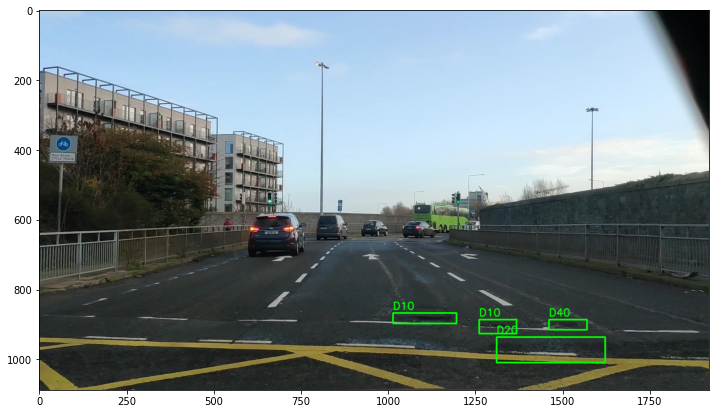

In [15]:
img = draw_bb('/content/test/DublinVideo1_scene01851_jpg.rf.8e93abb5b9884b43e60586b0ad79e7bf.jpg', '/content/test/DublinVideo1_scene01851_jpg.rf.8e93abb5b9884b43e60586b0ad79e7bf.xml')
plt.figure(figsize=(12,8))
plt.subplot(1,1,1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

In [ ]:
!ls -lh test | wc -l

321


In [ ]:
sampled_dataset = dataset.sample(50)
sampled_dataset = sampled_dataset.reset_index(drop=True)
sampled_dataset.head()

,images,annotations
0,/content/test/MaynoothVideo11_scene05601_jpg.r...,/content/test/MaynoothVideo11_scene05601_jpg.r...
1,/content/test/MaynoothVideo10_scene09761_jpg.r...,/content/test/MaynoothVideo10_scene09761_jpg.r...
2,/content/test/MaynoothVideo12_scene05841_jpg.r...,/content/test/MaynoothVideo12_scene05841_jpg.r...
3,/content/test/LiffeyValleyVideo1_scene04721_jp...,/content/test/LiffeyValleyVideo1_scene04721_jp...
4,/content/test/MaynoothScene8-scene02191_jpg.rf...,/content/test/MaynoothScene8-scene02191_jpg.rf...


In [ ]:
for i in range(sampled_dataset.shape[0]):
  img = draw_bb(sampled_dataset['images'].tolist()[i], sampled_dataset['annotations'].tolist()[i])
  plt.figure(figsize=(12,8))
  plt.subplot(1,1,1)
  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
!cp -r '/content/drive/MyDrive/College/Thesis/Data/Ireland Road Damage Test Set.v2_yolov5.zip' ./

In [ ]:
!mkdir ireland_test_set

In [ ]:
!unzip 'Ireland Road Damage Test Set.v2_yolov5.zip' -d ireland_test_set/

Archive:  Ireland Road Damage Test Set.v2_yolov5.zip
 extracting: ireland_test_set/README.dataset.txt  
 extracting: ireland_test_set/README.roboflow.txt  
 extracting: ireland_test_set/data.yaml  
   creating: ireland_test_set/test/
   creating: ireland_test_set/test/images/
 extracting: ireland_test_set/test/images/BelfastVideo1_scene01881_jpg.rf.3d866356d50fceb7794150d165e10ce9.jpg  
 extracting: ireland_test_set/test/images/BelfastVideo1_scene02141_jpg.rf.4d24ff3ce4e4d3224adb219337cc9c2f.jpg  
 extracting: ireland_test_set/test/images/BelfastVideo1_scene02441_jpg.rf.580706f4699527cfce3470b1cb02990a.jpg  
 extracting: ireland_test_set/test/images/BelfastVideo1_scene02461_jpg.rf.b0c996c2d798186136e63dfe573ba4a0.jpg  
 extracting: ireland_test_set/test/images/BelfastVideo1_scene02851_jpg.rf.172b728c61e2aef67fa56cd3c03acdb4.jpg  
 extracting: ireland_test_set/test/images/BelfastVideo1_scene03421_jpg.rf.c74ce187856e823aa0023442036ade31.jpg  
 extracting: ireland_test_set/test/images/Bel

In [ ]:
!zip -r ireland_test_set_yolov2.zip ireland_test_set

  adding: ireland_test_set/ (stored 0%)
  adding: ireland_test_set/data.yaml (deflated 12%)
  adding: ireland_test_set/.ipynb_checkpoints/ (stored 0%)
  adding: ireland_test_set/obj.names (deflated 20%)
  adding: ireland_test_set/test/ (stored 0%)
  adding: ireland_test_set/test/images/ (stored 0%)
  adding: ireland_test_set/test/images/BelfastVideo1_scene03841_jpg.rf.7918ab8291e3cadb74dd991e689b94dc.jpg (deflated 0%)
  adding: ireland_test_set/test/images/LiffeyValleyVideo1_scene07201_jpg.rf.2d7179355fe270f8e99a407084d58d5c.jpg (deflated 4%)
  adding: ireland_test_set/test/images/BelfastVideo1_scene03821_jpg.rf.c578596d2e12c54f214f4939265ebe5d.jpg (deflated 0%)
  adding: ireland_test_set/test/images/LiffeyValleyVideo1_scene08711_jpg.rf.4ef3c55b9e2814b27acc38b24c9ecfa5.jpg (deflated 5%)
  adding: ireland_test_set/test/images/MaynoothVideo11_scene02671_jpg.rf.7ec09a213f2eba0820d5d1a7a13cda9c.jpg (deflated 2%)
  adding: ireland_test_set/test/images/BelfastVideo1_scene27901_jpg.rf.d0c5235

In [ ]:
!cp -r /content/ireland_test_set_yolov2.zip /content/drive/MyDrive/College/Thesis/Data/

In [ ]:
!mkdir -p ireland_test_set/images/ireland_test_set
!mkdir -p ireland_test_set/labels/ireland_test_set

In [ ]:
!mv -v /content/ireland_test_set/obj_train_data/*.jpg /content/ireland_test_set/images

renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene01881.jpg' -> '/content/ireland_test_set/images/BelfastVideo1_scene01881.jpg'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02141.jpg' -> '/content/ireland_test_set/images/BelfastVideo1_scene02141.jpg'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02441.jpg' -> '/content/ireland_test_set/images/BelfastVideo1_scene02441.jpg'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02461.jpg' -> '/content/ireland_test_set/images/BelfastVideo1_scene02461.jpg'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02851.jpg' -> '/content/ireland_test_set/images/BelfastVideo1_scene02851.jpg'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene03421.jpg' -> '/content/ireland_test_set/images/BelfastVideo1_scene03421.jpg'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene03431.jpg' -> '/content/ireland_test_set/images/B

In [ ]:
!mv -v /content/ireland_test_set/obj_train_data/*.txt /content/ireland_test_set/labels

renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene01881.txt' -> '/content/ireland_test_set/labels/BelfastVideo1_scene01881.txt'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02141.txt' -> '/content/ireland_test_set/labels/BelfastVideo1_scene02141.txt'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02441.txt' -> '/content/ireland_test_set/labels/BelfastVideo1_scene02441.txt'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02461.txt' -> '/content/ireland_test_set/labels/BelfastVideo1_scene02461.txt'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene02851.txt' -> '/content/ireland_test_set/labels/BelfastVideo1_scene02851.txt'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene03421.txt' -> '/content/ireland_test_set/labels/BelfastVideo1_scene03421.txt'
renamed '/content/ireland_test_set/obj_train_data/BelfastVideo1_scene03431.txt' -> '/content/ireland_test_set/labels/B

In [ ]:
!rm -r /content/ireland_test_set/obj_train_data

In [ ]:
!tar -cvzf ireland_test_set.tar.gz ireland_test_set

ireland_test_set/
ireland_test_set/obj.data
ireland_test_set/obj.names
ireland_test_set/train.txt
ireland_test_set/data.yaml
ireland_test_set/.ipynb_checkpoints/
ireland_test_set/labels/
ireland_test_set/labels/MaynoothVideo15_scene03411.txt
ireland_test_set/labels/DublinVideo2_scene17061.txt
ireland_test_set/labels/LiffeyValleyVideo2_scene02801.txt
ireland_test_set/labels/MaynoothVideo12_scene15561.txt
ireland_test_set/labels/MaynoothVideo10_scene09311.txt
ireland_test_set/labels/BelfastVideo1_scene23861.txt
ireland_test_set/labels/MaynoothVideo14_scene01441.txt
ireland_test_set/labels/MaynoothVideo10_scene01491.txt
ireland_test_set/labels/DublinVideo9_scene08061.txt
ireland_test_set/labels/MaynoothVideo12_scene24921.txt
ireland_test_set/labels/DublinVideo9_scene06431.txt
ireland_test_set/labels/DublinVideo9_scene16491.txt
ireland_test_set/labels/DublinVideo1_scene22071.txt
ireland_test_set/labels/MaynoothVideo10_scene01341.txt
ireland_test_set/labels/BelfastVideo1_scene04361.txt
irel

In [ ]:
!cp -r ireland_test_set.tar.gz /content/drive/MyDrive/College/Thesis/Data

In [ ]:
!cp -r /content/drive/MyDrive/College/Thesis/Data/ireland_test_set_yolov2.zip ./

In [ ]:
!unzip ireland_test_set_yolov2.zip

Archive:  ireland_test_set_yolov2.zip
   creating: ireland_test_set/
  inflating: ireland_test_set/data.yaml  
   creating: ireland_test_set/.ipynb_checkpoints/
  inflating: ireland_test_set/obj.names  
   creating: ireland_test_set/test/
   creating: ireland_test_set/test/images/
  inflating: ireland_test_set/test/images/BelfastVideo1_scene03841_jpg.rf.7918ab8291e3cadb74dd991e689b94dc.jpg  
  inflating: ireland_test_set/test/images/LiffeyValleyVideo1_scene07201_jpg.rf.2d7179355fe270f8e99a407084d58d5c.jpg  
  inflating: ireland_test_set/test/images/BelfastVideo1_scene03821_jpg.rf.c578596d2e12c54f214f4939265ebe5d.jpg  
  inflating: ireland_test_set/test/images/LiffeyValleyVideo1_scene08711_jpg.rf.4ef3c55b9e2814b27acc38b24c9ecfa5.jpg  
  inflating: ireland_test_set/test/images/MaynoothVideo11_scene02671_jpg.rf.7ec09a213f2eba0820d5d1a7a13cda9c.jpg  
  inflating: ireland_test_set/test/images/BelfastVideo1_scene27901_jpg.rf.d0c52356797391bb2eef7823f449feba.jpg  
  inflating: ireland_test_se

In [ ]:
!cp -r /content/drive/MyDrive/College/Thesis/Data/ireland_test_set_yolo.zip ./

In [ ]:
!unzip ireland_test_set_yolo.zip

Archive:  ireland_test_set_yolo.zip
 extracting: train.txt               
 extracting: obj.names               
 extracting: obj.data                
 extracting: obj_train_data/MaynoothVideo10_scene04331.txt  
 extracting: obj_train_data/MaynoothVideo15_scene02561.jpg  
 extracting: obj_train_data/LiffeyValleyVideo2_scene04671.jpg  
 extracting: obj_train_data/DublinVideo12scene00321.txt  
 extracting: obj_train_data/DublinVideo10IMG_20220127_153151.jpg  
 extracting: obj_train_data/BelfastVideo1_scene06801.txt  
 extracting: obj_train_data/DublinVideo1_scene06921.jpg  
 extracting: obj_train_data/BelfastVideo1_scene04641.jpg  
 extracting: obj_train_data/DublinVideo9_scene16771.jpg  
 extracting: obj_train_data/MaynoothVideo12_scene05841.txt  
 extracting: obj_train_data/DublinVideo1_scene15381.jpg  
 extracting: obj_train_data/DublinVideo2_scene00001.jpg  
 extracting: obj_train_data/BelfastVideo1_scene03841.txt  
 extracting: obj_train_data/LiffeyValleyVideo1_scene07201.txt  
 extr

In [ ]:
!pip install roboflow



     |████████████████████████████████| 1.1 MB 7.6 MB/s 
     |████████████████████████████████| 67 kB 4.9 MB/s 
     |████████████████████████████████| 138 kB 55.4 MB/s 
     |████████████████████████████████| 596 kB 43.2 MB/s 
     |████████████████████████████████| 178 kB 43.3 MB/s 
     |████████████████████████████████| 145 kB 43.2 MB/s 
     |████████████████████████████████| 63 kB 1.4 MB/s 
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9675 sha256=8116ae87473024f5c0ab6eeb62e531ce8e10b88d56d39d8db68de69b5610eebe
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.7
    Uninstalling pyparsing-3.0.7:
      Successfully uninstalled pyparsing-3.0.7
  

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="xVsQlNMTya7zzrDKgg2c")
project = rf.workspace("myles-cullen").project("ireland-road-damage-test-set")
dataset = project.version(3).download("voc")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Ireland-Road-Damage-Test-Set-3 in voc:: 100%|██████████| 323/323 [00:04<00:00, 67.18it/s]


In [ ]:
imgs, annots = binder('/content/Ireland-Road-Damage-Test-Set-3/test')

In [ ]:
import pandas as pd

dataset = pd.DataFrame({'images' : imgs, 'annotations' : annots})
dataset.head()

,images,annotations
0,/content/Ireland-Road-Damage-Test-Set-3/test/B...,/content/Ireland-Road-Damage-Test-Set-3/test/B...
1,/content/Ireland-Road-Damage-Test-Set-3/test/B...,/content/Ireland-Road-Damage-Test-Set-3/test/B...
2,/content/Ireland-Road-Damage-Test-Set-3/test/B...,/content/Ireland-Road-Damage-Test-Set-3/test/B...
3,/content/Ireland-Road-Damage-Test-Set-3/test/B...,/content/Ireland-Road-Damage-Test-Set-3/test/B...
4,/content/Ireland-Road-Damage-Test-Set-3/test/B...,/content/Ireland-Road-Damage-Test-Set-3/test/B...


In [ ]:
df_imgs, df_labels = filter_out_unused_labels(dataset)

Streaming output truncated to the last 5000 lines.
<Element 'depth' at 0x7f75cfd0cb90>
False
3
<class 'str'>
<Element 'name' at 0x7f75cfd0ccb0>
False
D40
<class 'str'>
<Element 'pose' at 0x7f75cfd0cd10>
False
Unspecified
<class 'str'>
<Element 'truncated' at 0x7f75cfd0cd70>
False
0
<class 'str'>
<Element 'difficult' at 0x7f75cfd0cdd0>
False
0
<class 'str'>
<Element 'occluded' at 0x7f75cfd0ce30>
False
0
<class 'str'>
<Element 'bndbox' at 0x7f75cfd0ce90>
False

			
<class 'str'>
<Element 'name' at 0x7f75cfcba170>
False
D20
<class 'str'>
<Element 'pose' at 0x7f75cfcba1d0>
False
Unspecified
<class 'str'>
<Element 'truncated' at 0x7f75cfcba230>
False
0
<class 'str'>
<Element 'difficult' at 0x7f75cfcba290>
False
0
<class 'str'>
<Element 'occluded' at 0x7f75cfcba2f0>
False
0
<class 'str'>
<Element 'bndbox' at 0x7f75cfcba350>
False

			
<class 'str'>
<Element 'database' at 0x7f75cfd0c1d0>
False
roboflow.ai
<class 'str'>
<Element 'width' at 0x7f75cfd0c110>
False
1920
<class 'str'>
<Element 'hei

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


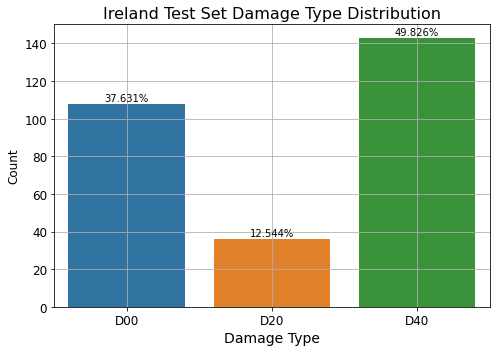

In [ ]:
generate_chart(df_labels, 'Ireland Test Set Damage Type Distribution')

In [ ]:
sampled_dataset = dataset.sample(50)
sampled_dataset = sampled_dataset.reset_index(drop=True)
sampled_dataset.head()

,images,annotations
0,/content/Ireland-Road-Damage-Test-Set-3/test/M...,/content/Ireland-Road-Damage-Test-Set-3/test/M...
1,/content/Ireland-Road-Damage-Test-Set-3/test/D...,/content/Ireland-Road-Damage-Test-Set-3/test/D...
2,/content/Ireland-Road-Damage-Test-Set-3/test/M...,/content/Ireland-Road-Damage-Test-Set-3/test/M...
3,/content/Ireland-Road-Damage-Test-Set-3/test/D...,/content/Ireland-Road-Damage-Test-Set-3/test/D...
4,/content/Ireland-Road-Damage-Test-Set-3/test/B...,/content/Ireland-Road-Damage-Test-Set-3/test/B...


/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo14_scene01441_jpg.rf.8069848829f2d4b2197422d019f66a3e.jpg
703
1556


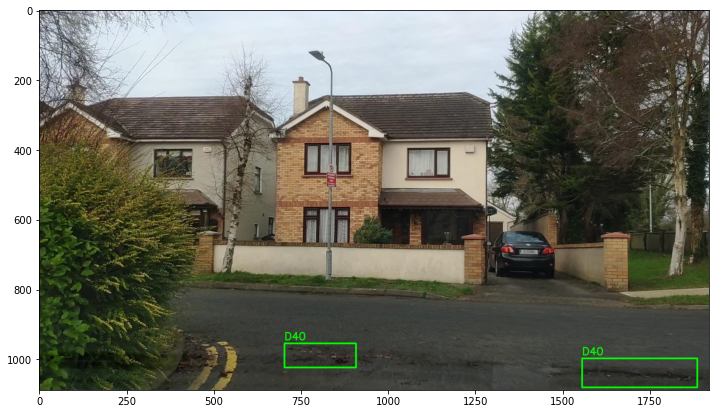

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9_scene22871_jpg.rf.093d100be3bd53320982f139cf46d44f.jpg
942


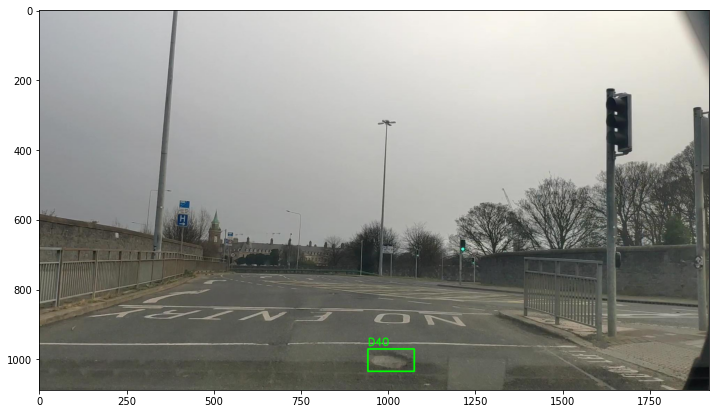

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo2_scene10101_jpg.rf.6361daa5fafeab071fcee17835425717.jpg
724


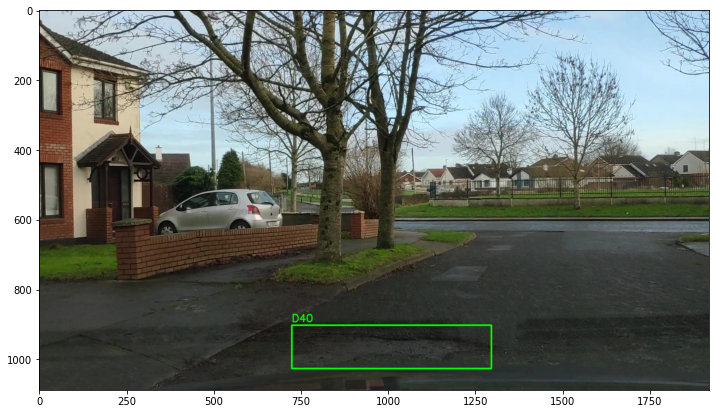

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo2_scene16181_jpg.rf.57280c246ca40e444f4881d12b7e565c.jpg
889


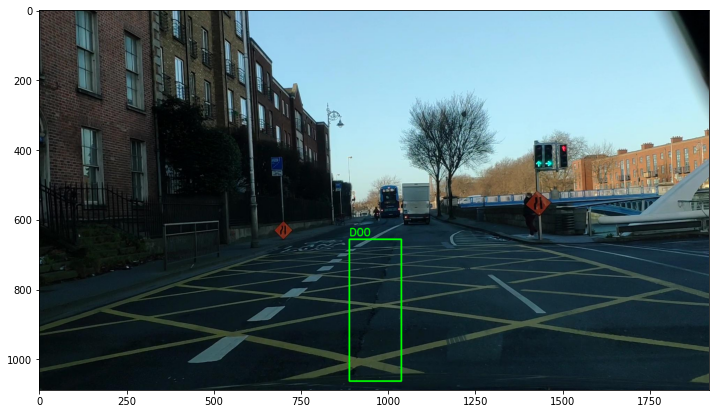

/content/Ireland-Road-Damage-Test-Set-3/test/BelfastVideo1_scene27901_jpg.rf.a0563006d4f128b92d239d4d411e06ee.jpg
830


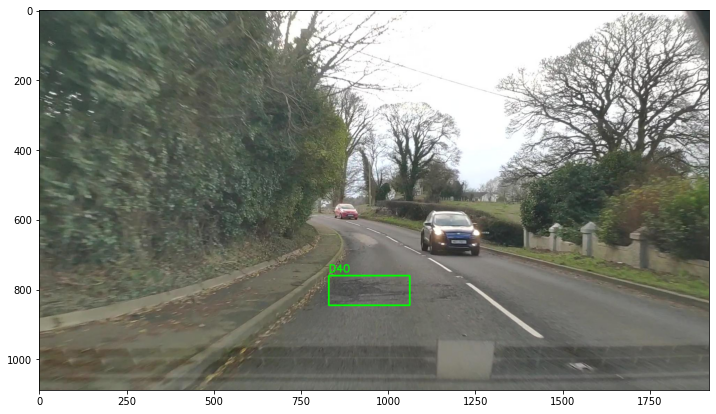

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo11_scene02671_jpg.rf.558e48a78172cd9bac941a0ee7b27d20.jpg
1226
1506


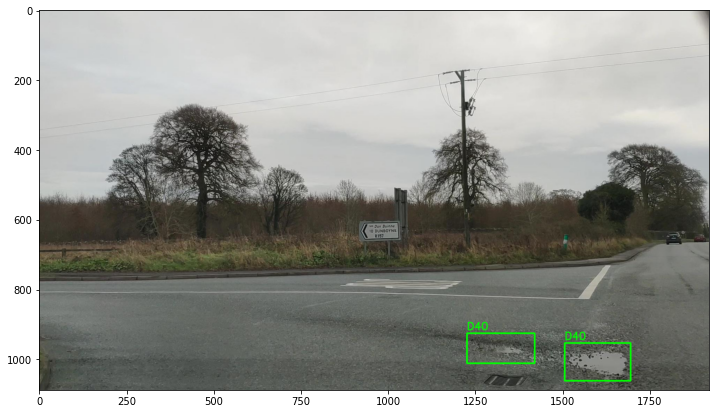

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo12_scene05841_jpg.rf.3327b2bae39b36a7e22de17a502a30d3.jpg
865


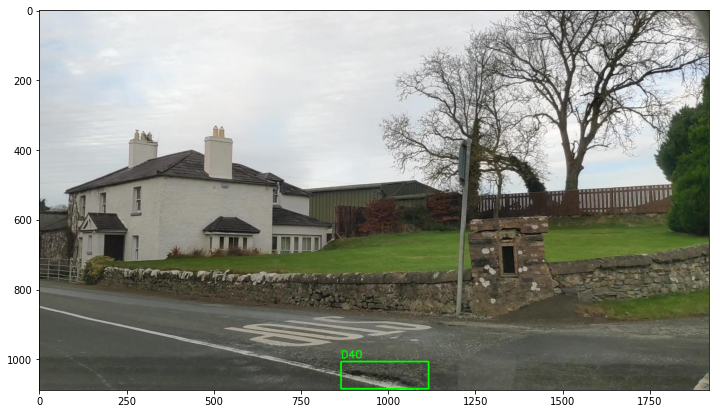

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9_scene23171_jpg.rf.390903be8e95725531f2efec040f1d59.jpg
931


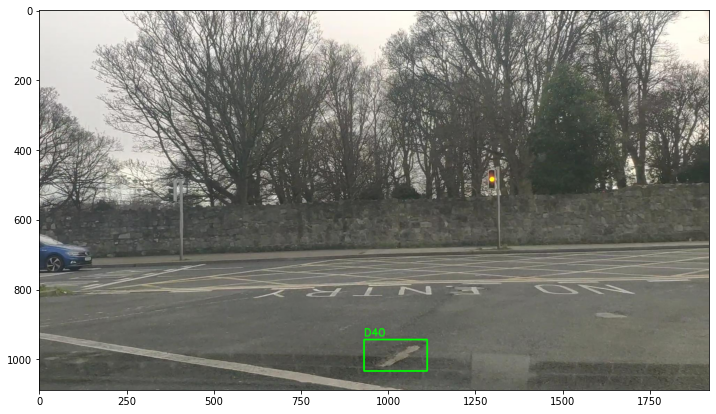

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo12_scene25541_jpg.rf.de1e5d0f8525532bb240d255405b31b1.jpg
805


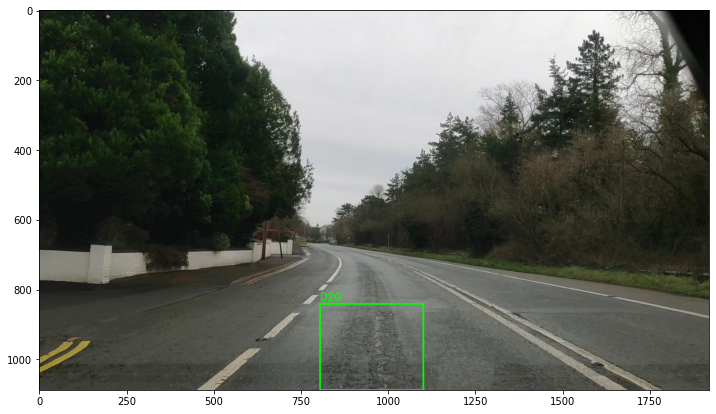

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo15_scene03231_jpg.rf.f7dd27e42736835beddb650ba56c8ae0.jpg
905
991
733


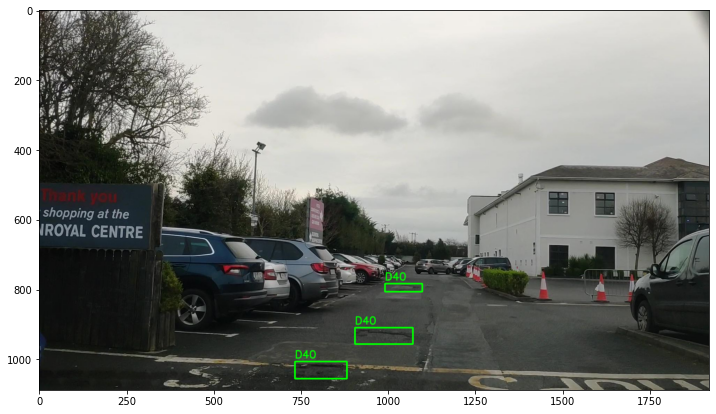

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9_scene14221_jpg.rf.f9677f6ff5b95efb550c0d54145726bc.jpg
564
551


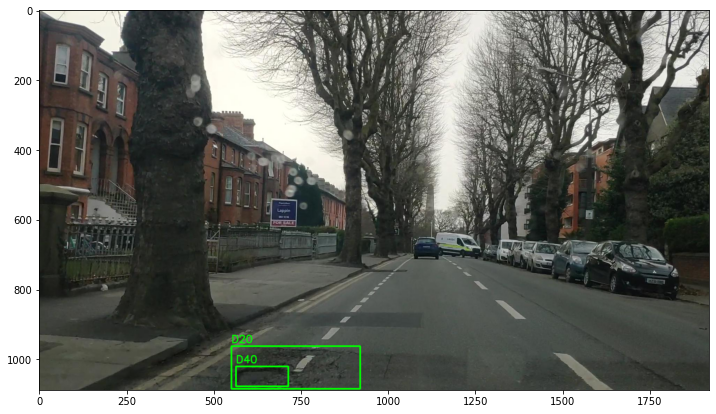

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo1_scene00701_jpg.rf.fecd0a17b401ccc4e2d7634efc343240.jpg
25
498


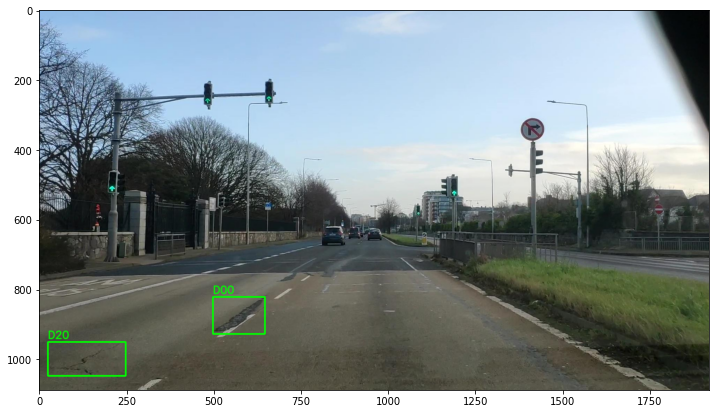

/content/Ireland-Road-Damage-Test-Set-3/test/BelfastVideo1_scene04361_jpg.rf.3e4f1dd6b78bc25ab116dd36ad470e7f.jpg
1076


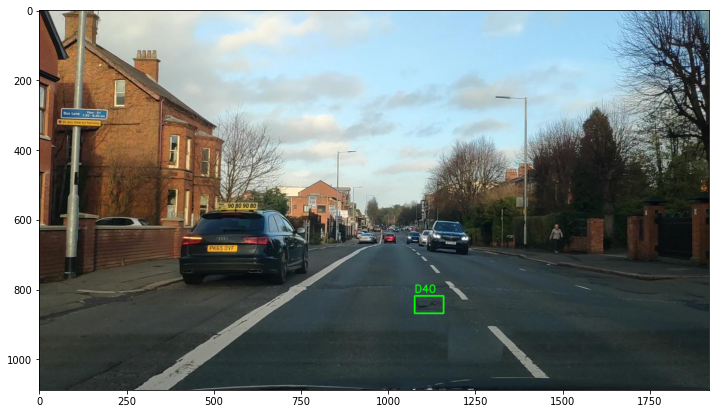

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo2_scene07921_jpg.rf.8772749b597166e9df427b3d10dc2bdd.jpg
1328


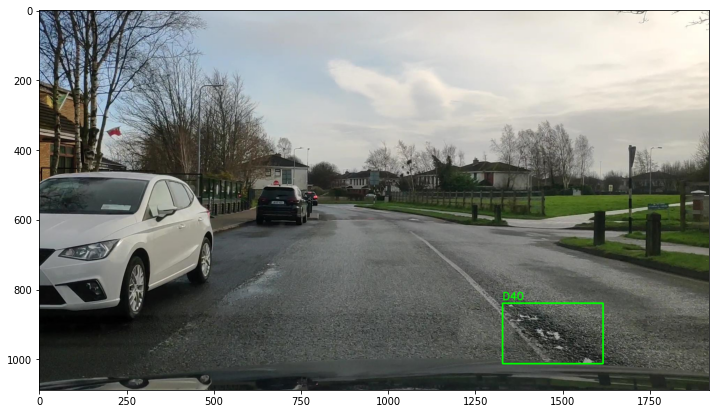

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo10_scene04331_jpg.rf.d3256f1d917d43117e5eab2d55c09719.jpg
518


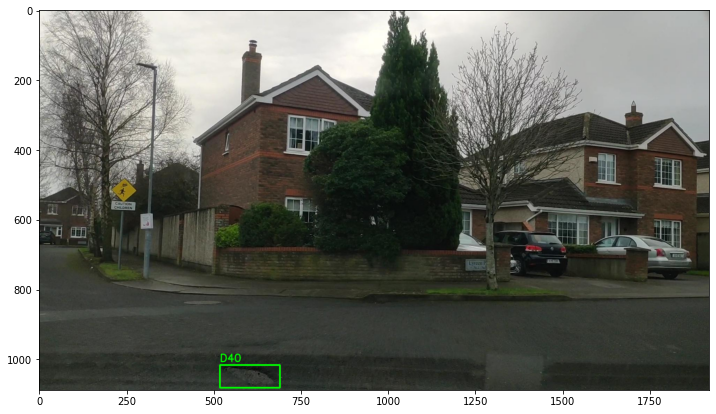

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo1_scene15861_jpg.rf.a3058c0e7af26e05243d9b872ed91e22.jpg
1453
631


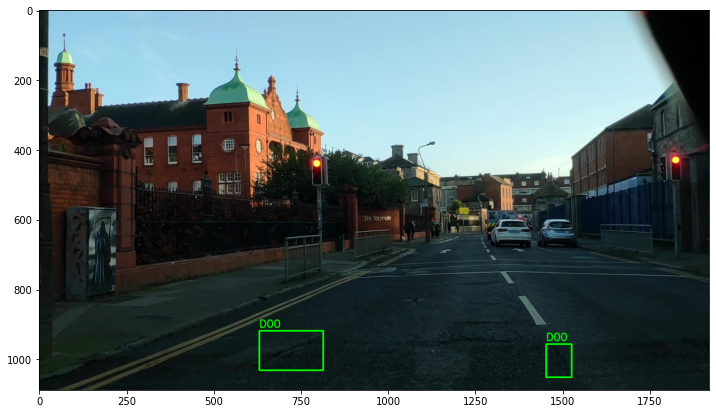

/content/Ireland-Road-Damage-Test-Set-3/test/BelfastVideo1_scene03421_jpg.rf.dbc0fd213eaea4640a8212a1a6e6ad40.jpg
673
1075
575
1401


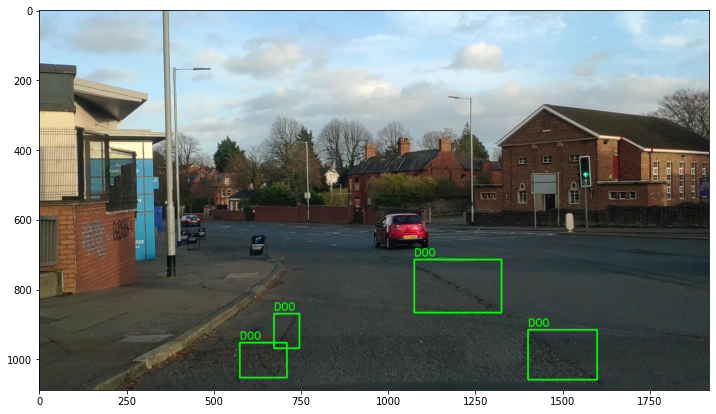

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo4_scene03281_jpg.rf.d867b7eca583185e261511e0b7ba4183.jpg
498
399
447


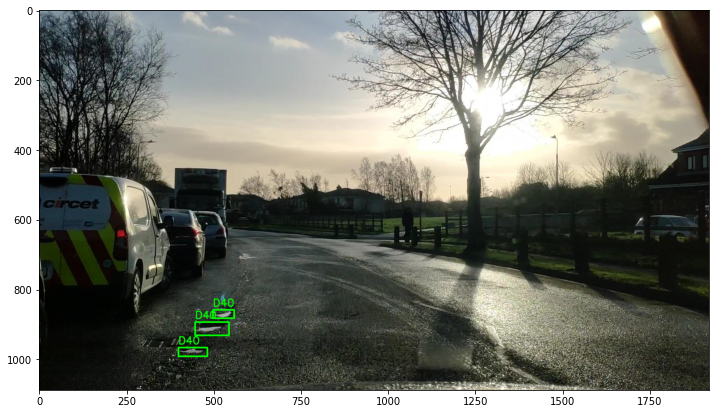

/content/Ireland-Road-Damage-Test-Set-3/test/LiffeyValleyVideo2_scene02861_jpg.rf.d1a8ac2cda6b3c36abb8afc2fdc98d7e.jpg
1332
533


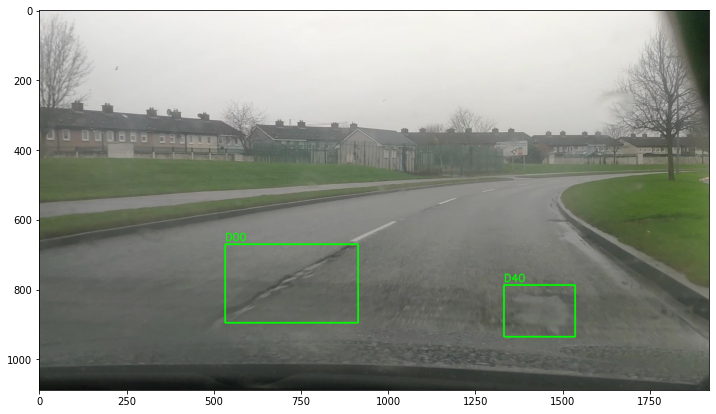

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo2_scene18111_jpg.rf.5389810c89dd617b09097637e7ab067e.jpg
723


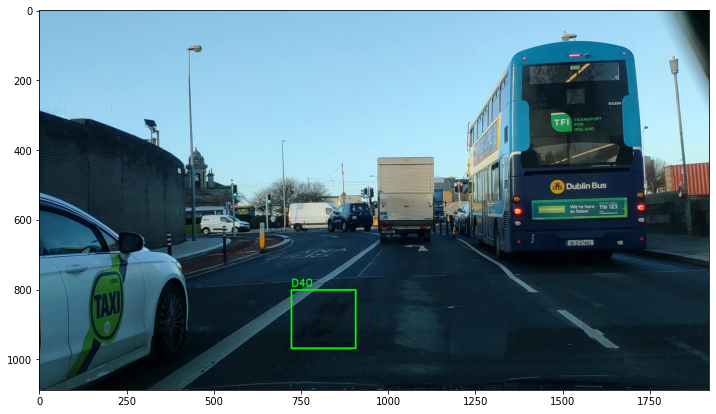

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9_scene23001_jpg.rf.dcc4abe3b62e93708a1e86a4537ecae6.jpg
1255
1129
977
805
1332
1846
878


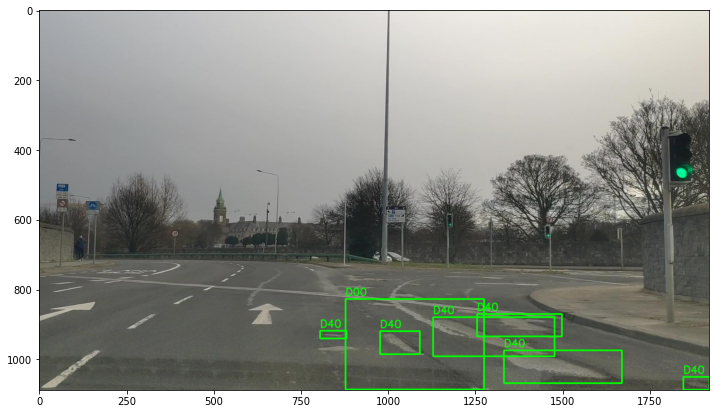

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9_scene16651_jpg.rf.f70f01e4f7e6906602847aa9172d1f80.jpg
1021


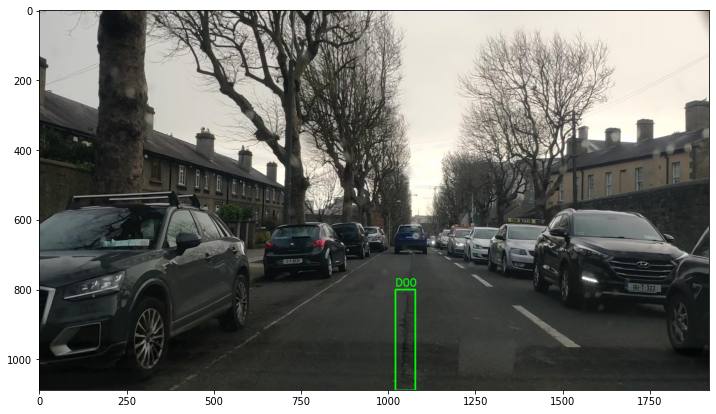

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo11_scene08561_jpg.rf.46a4278d9a60adfedbc7f7df5d594920.jpg


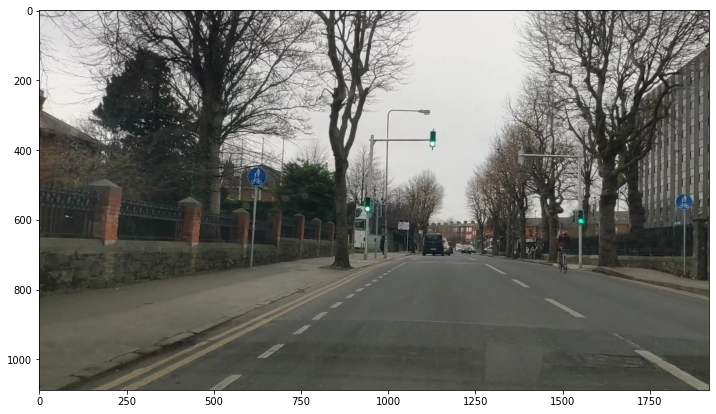

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo1_scene16301_jpg.rf.aada60cdc3d910e9a0a416559406eb0a.jpg
1299


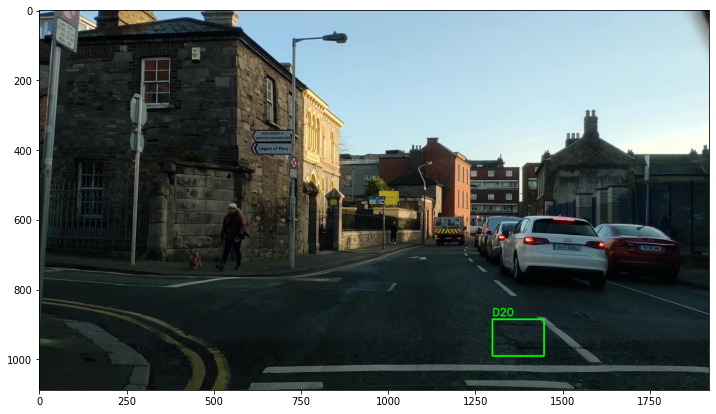

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo10_scene01491_jpg.rf.3790489cd08f683caddbcd8c390cb9b2.jpg
1166


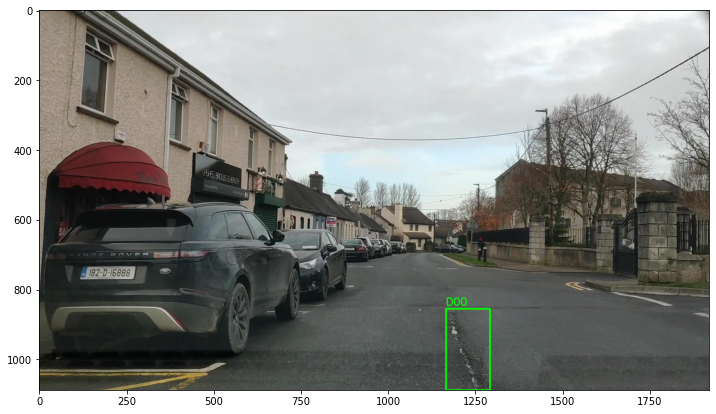

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo10_IMG_20220127_141035_jpg.rf.7c45f1d7775f6f7efa7e935fb9e75831.jpg
554
1599


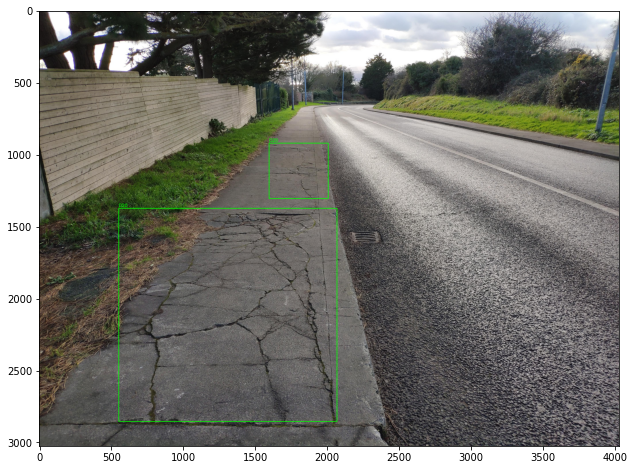

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo15_scene02101_jpg.rf.20936fd909f52f3ae58dfb65413c945b.jpg
1399
331


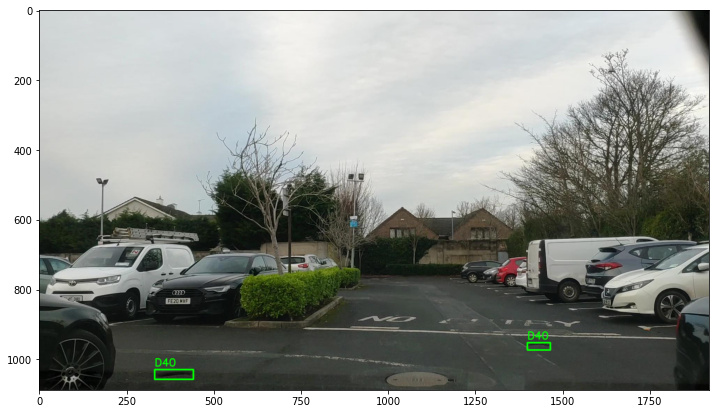

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo10IMG_20220127_153151_jpg.rf.84777af122d80258144505b99f46cf68.jpg
17
2382
1121
611
524


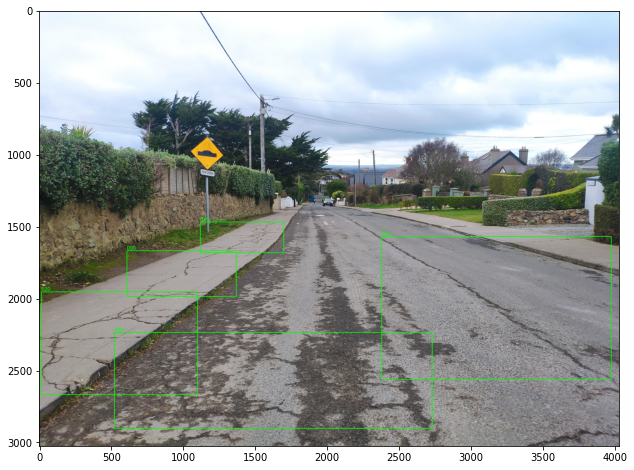

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo1_scene07701_jpg.rf.044d0365ae107cb5b3ea1f727ee3be2f.jpg
533
1308


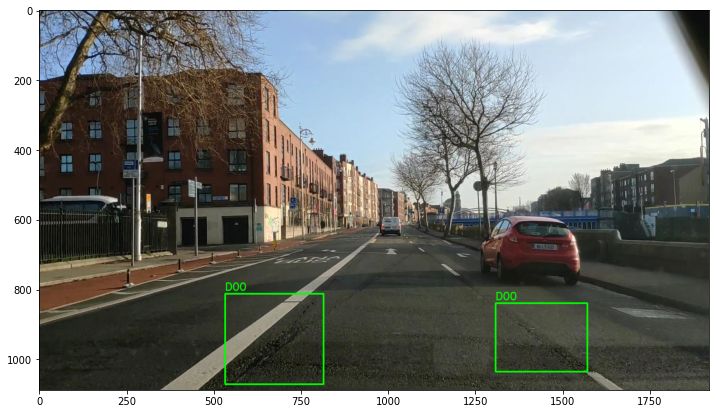

/content/Ireland-Road-Damage-Test-Set-3/test/BelfastVideo1_scene07071_jpg.rf.a2908474374c48a80913a3a50c18873b.jpg
949


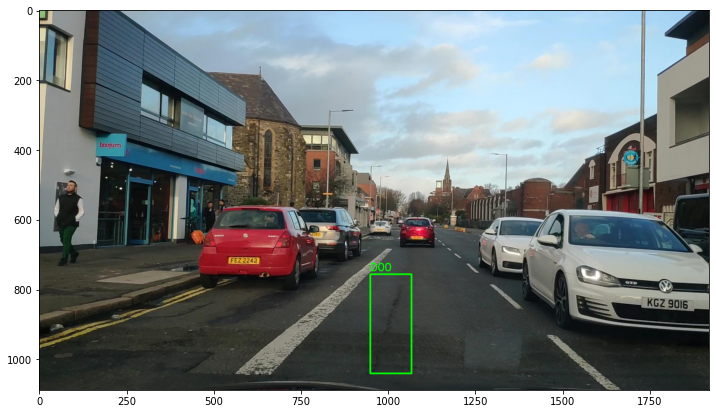

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo3_scene03011_jpg.rf.1a886f632bd70e569ed1426e3a483ee5.jpg


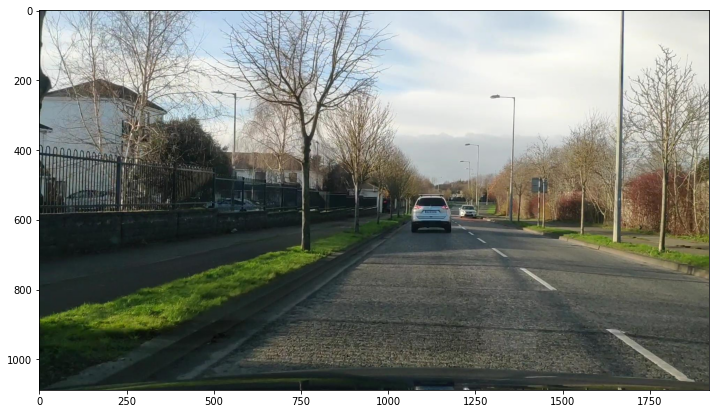

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo10_scene09311_jpg.rf.af6890a2c187b1cdbe16f79d38af88d8.jpg
855
1197
956
871
487


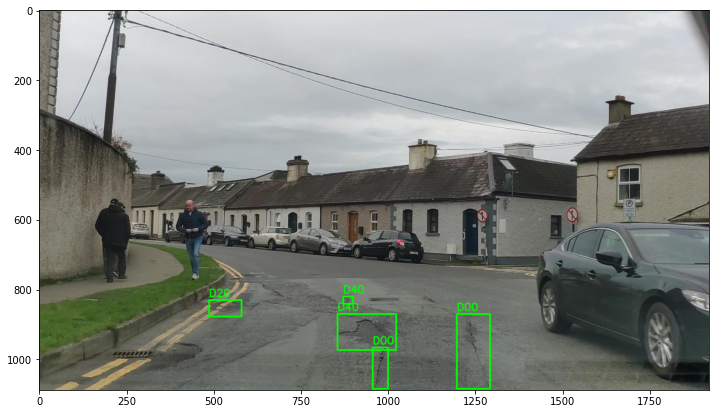

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo2_scene00001_jpg.rf.120ea90e0cb1c16c2f995adc1cc5bd6e.jpg
1115
1234


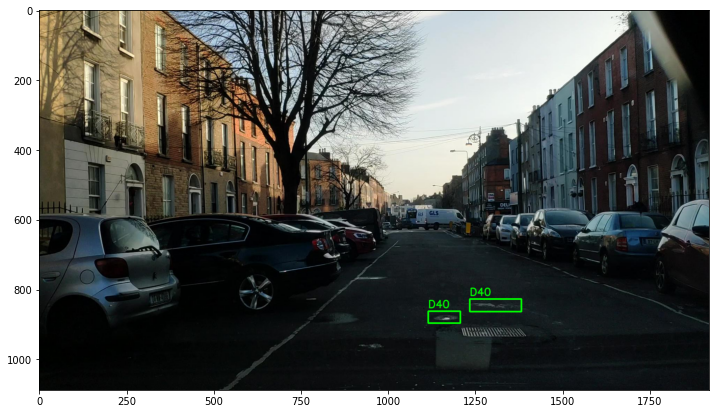

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo10IMG_20220127_153200_jpg.rf.fbf117481336f11f2279c96f81a85b92.jpg
23
2451
1923


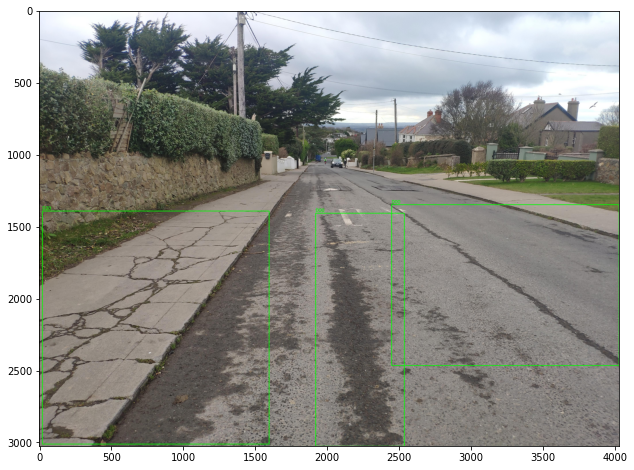

/content/Ireland-Road-Damage-Test-Set-3/test/LiffeyValleyVideo2_scene04411_jpg.rf.31224efaca475f12f10aa5a3bf99b5a1.jpg
427


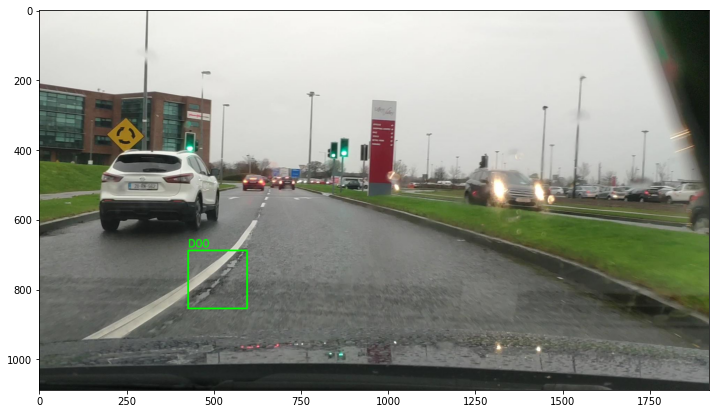

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9_scene22531_jpg.rf.03ae8a20c1b6dc4e33c1ba3f494579ac.jpg
788


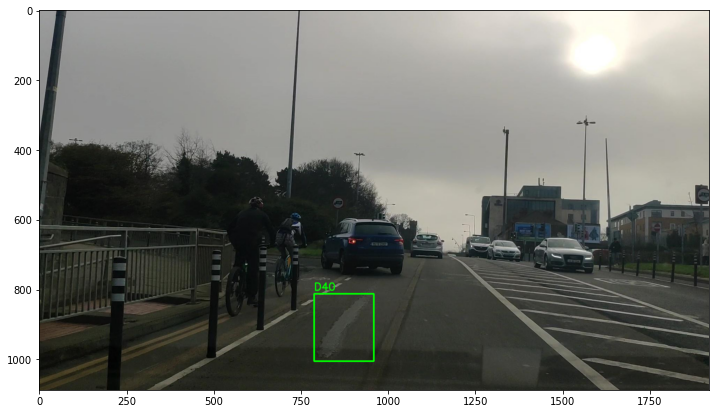

/content/Ireland-Road-Damage-Test-Set-3/test/BelfastVideo1_scene04081_jpg.rf.80315f6598fb5fa8fa5abc08a04d65ec.jpg
484
328


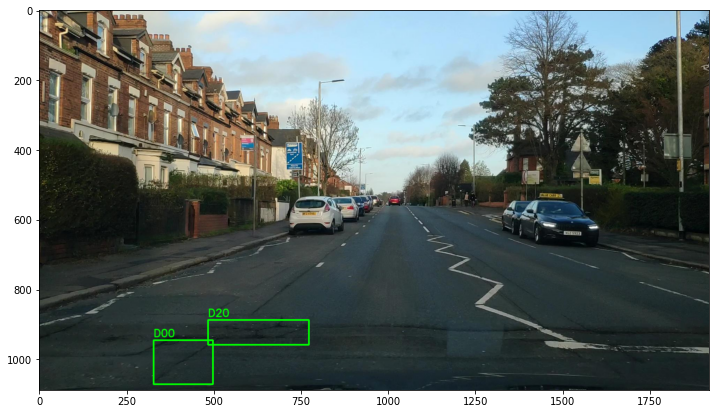

/content/Ireland-Road-Damage-Test-Set-3/test/BelfastVideo1_scene02141_jpg.rf.5632fa9d4b8b7c60d1830daab7264096.jpg
624
947


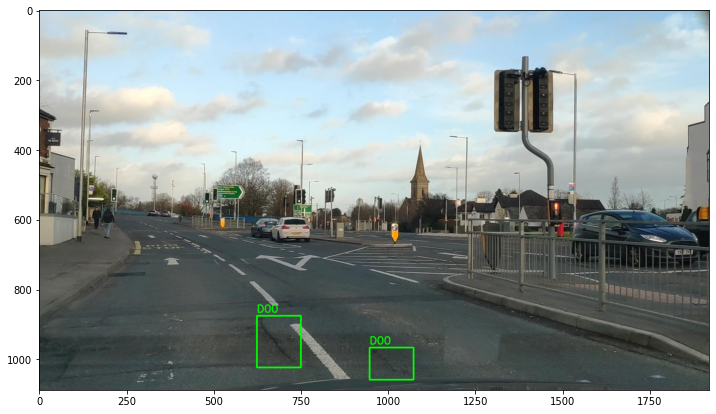

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo2_scene15841_jpg.rf.afed4999744b7334eb177d463e0bfb6a.jpg
624


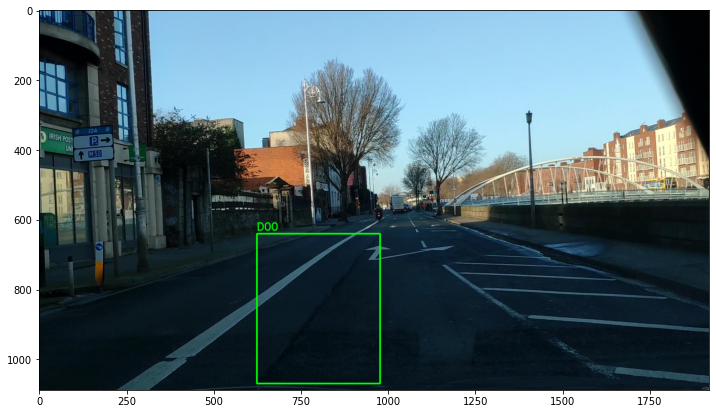

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9_scene22661_jpg.rf.aa1d2cded5532d1bc79207fd87d5853f.jpg
478
118
866
489


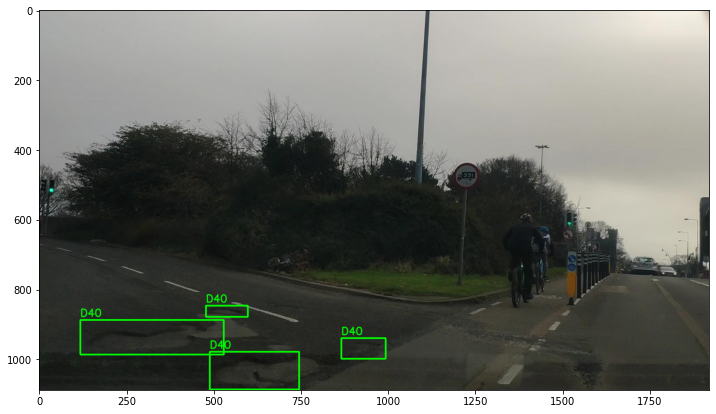

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo9scene06991_jpg.rf.7e62fc1ba94dd2e26af499a33b847116.jpg
1216


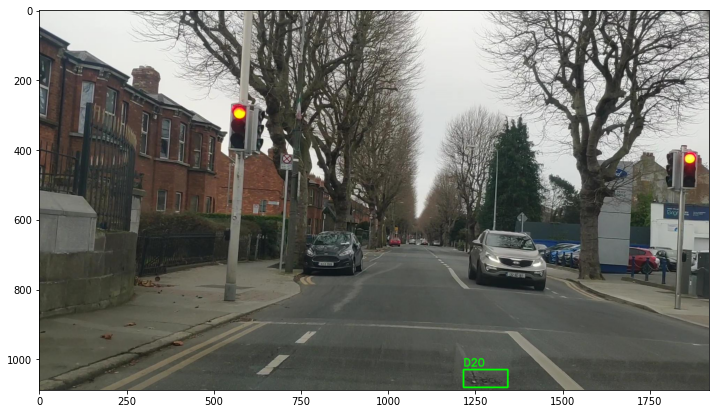

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo12_scene24801_jpg.rf.c110c824d7e183eef4fe8e4fc5066a04.jpg


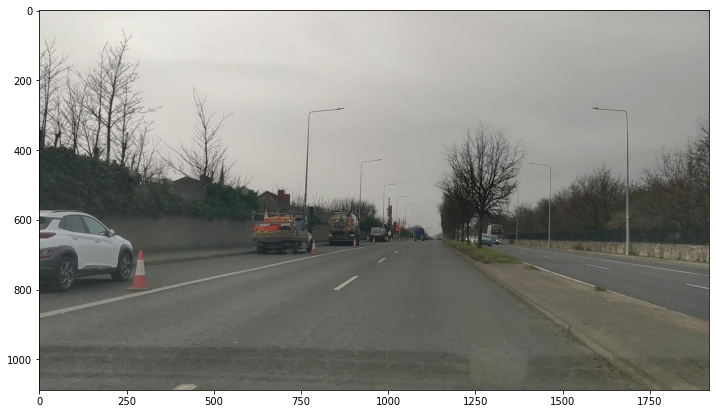

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo2_scene04531_jpg.rf.e620e0f85017df5df7854de6c48a2003.jpg
526
556
383
639
86


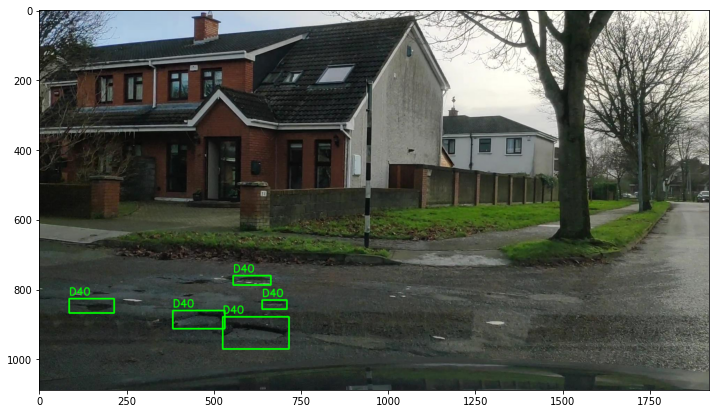

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo1_scene20701_jpg.rf.b7d72f2631609d3b23d03e9767a3ebe3.jpg
1109


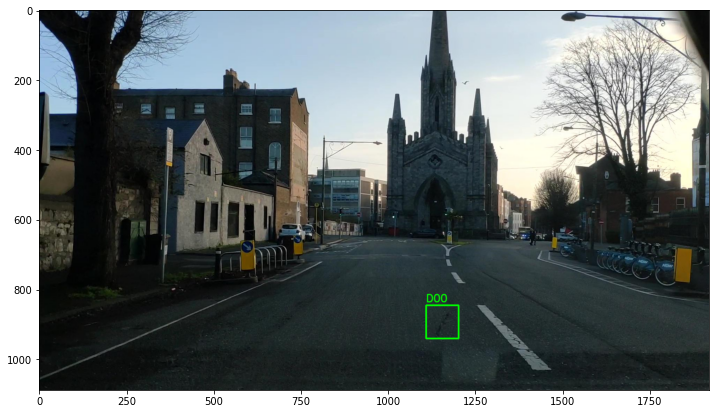

/content/Ireland-Road-Damage-Test-Set-3/test/DublinVideo1_scene15381_jpg.rf.f9d9e52897b10fdce8931899060fa2fa.jpg
1388


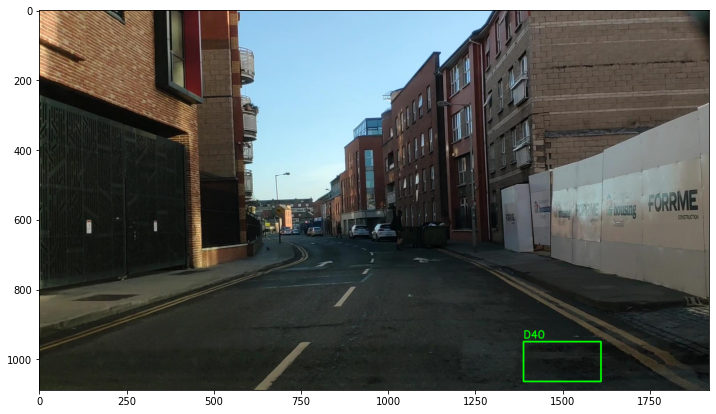

/content/Ireland-Road-Damage-Test-Set-3/test/BelfastVideo1_scene02441_jpg.rf.b89b1ca963b4d863c1df71e2bfd54894.jpg
1264
1230
1148


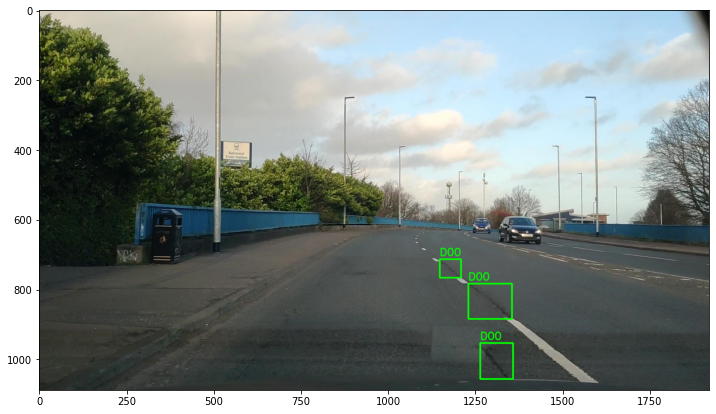

/content/Ireland-Road-Damage-Test-Set-3/test/LiffeyValleyVideo1_scene08711_jpg.rf.728279c27e73472c24cc4d42356ba883.jpg
521


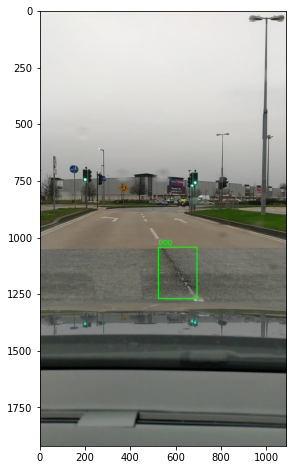

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo4_scene02601_jpg.rf.cabbf95e8ec5aab97d61002eca4829c0.jpg


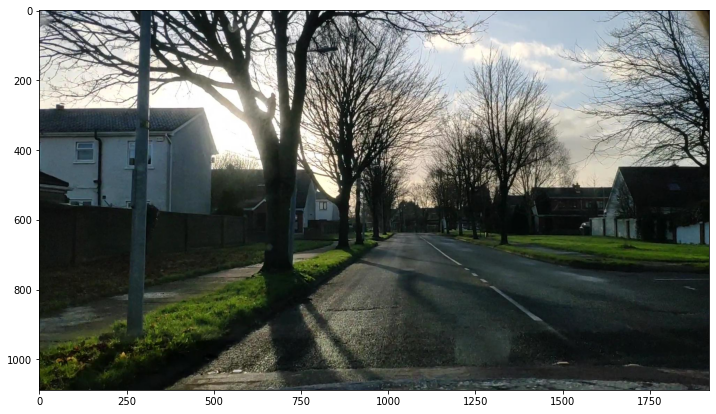

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo3_scene00581_jpg.rf.0375307efef4480c1180fa5a9333caa3.jpg


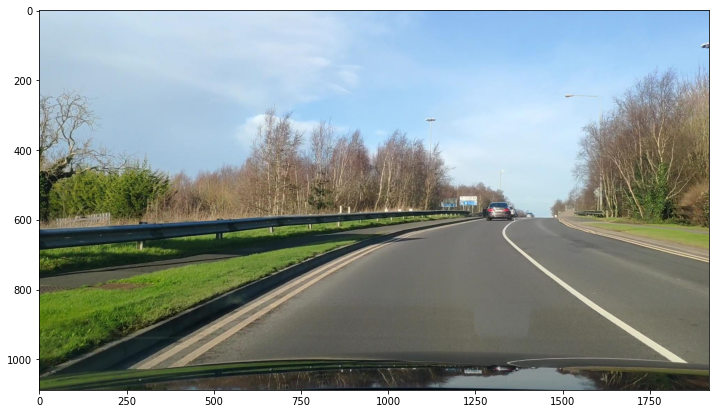

/content/Ireland-Road-Damage-Test-Set-3/test/MaynoothVideo10_scene09761_jpg.rf.c04dcbbd522df8d4d25fce288af53e10.jpg
1441


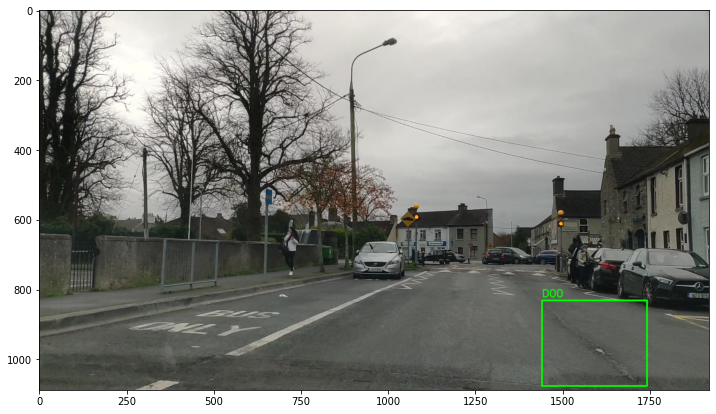

In [ ]:
for i in range(sampled_dataset.shape[0]):
  img = draw_bb(sampled_dataset['images'].tolist()[i], sampled_dataset['annotations'].tolist()[i])
  plt.figure(figsize=(12,8))
  plt.subplot(1,1,1)
  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()